In [2]:
import torch
import librosa
import mir_eval
import musdb
import numpy as np
from utils import *
import soundfile as sf
from datasets import Slakh_data, MUSDB_data
import IPython.display as ipd
from matplotlib import pyplot as plt
from eval_on_samples import eval_wave
from asteroid.models import ConvTasNet
from asteroid.losses import PITLossWrapper, pairwise_neg_sisdr

import os
os.environ['CUDA_DEVICE_ORDER']='PCI_BUS_ID'
os.environ['CUDA_VISIBLE_DEVICES']='3'

ImportError: cannot import name 'eval_wave'

#### Baseline

In [2]:
data = MUSDB_data('test', 4)
loader = torch.utils.data.DataLoader(testdata, batch_size = 3, shuffle = True, num_workers = 1)

In [13]:
n_src = 4
track = '/media/sdc1/slakh2100_wav/train/Track00003'
# model_name = '0319_134808'
# model_name = '0325_172544'
model_base = '0417_200733'
model_prop1 = '0417_200917' # prop1
model_prop2 = '0417_200832' # prop2
# model_prop2_2 = '0329_080354'
prop2 = False
ratio = [1,10,10,3] # piano, drum, bass, guitar
source_ratio, mask_ratio = sampling_ratio(1, n_src, True)
# model = ConvTasNet(n_src=n_src).cuda()
# model.load_state_dict(torch.load('../Model/'+model_name+'.pth'))
# pit_loss_func = PITLossWrapper(pairwise_neg_sisdr, pit_from='pw_mtx') # 
# sep_score, remix_score = test_model(model, test_data, pit_loss_func, debugging = False, \
#                                     remix_ratio=[1,1,1,1], ratio_on_rep=False, baseline=True)

In [32]:
est_sources_prop2, sources, est_mixture,mixtures= \
eval_wave(n_src=n_src, model_name = model_prop2, ratio=ratio,prop2=True, track = track, mask_ratio=mask_ratio)

tensor([[[[1.6925]],

         [[1.9669]],

         [[2.2296]],

         [[3.0201]]]], device='cuda:0')


In [15]:
est_sources_prop1, sources, est_mixture,mixtures= \
eval_wave(n_src=n_src, model_name = model_prop1, ratio=ratio,prop2=False, track = track)

None


In [16]:
est_sources_base, sources, est_mixture,mixtures= \
eval_wave(n_src=n_src, model_name = model_base, ratio=ratio,prop2=False, track = track)

None


In [17]:
remixture = np.dot(np.array(ratio), np.array(sources))

In [20]:
source_ratio = source_ratio.cpu().data.numpy()[0,:,0]

In [21]:
est_remixture_base = np.dot(np.array(source_ratio), np.array(est_sources_base))
est_remixture_prop1 = np.dot(np.array(source_ratio), np.array(est_sources_prop1))
est_remixture_prop2 = np.sum(np.array(est_sources_prop2), 0)

In [27]:
ipd.Audio(mixtures, rate=44100)
# sf.write('../Samples/orig_mixture_4src.wav', mixtures/max(mixtures), 44100, 'PCM_24')

In [28]:
ipd.Audio(remixture, rate=44100)
# sf.write('../Samples/orig_4src.wav', remixture/max(remixture), 44100, 'PCM_24')

In [29]:
ipd.Audio(est_remixture_base, rate=44100)
# sf.write('../Samples/baseline_4src.wav', est_remixture_base/max(est_remixture_base), 44100, 'PCM_24')

In [30]:
ipd.Audio(est_remixture_prop1, rate=44100)
# sf.write('../Samples/prop1_4src.wav', est_remixture_prop1/max(est_remixture_prop1), 44100, 'PCM_24')

In [31]:
ipd.Audio(est_remixture_prop2, rate=44100)
# sf.write('../Samples/prop2_4src.wav', est_remixture_prop2/max(est_remixture_prop2), 44100, 'PCM_24')

In [14]:
print(est_remixture_prop2.shape)

(4,)


In [ ]:
est_remixture_prop2_2 = np.dot(np.array(ratio), np.array(est_sources_prop2_2))
# ipd.Audio(est_remixture_prop2_2, rate=44100)

In [ ]:
sdr, sir, sar, perm \
= mir_eval.separation.bss_eval_sources(sources,est_sources_prop2, compute_permutation=False)

In [ ]:
print('sdr:{}\nsir:{}\nsar:{}\n'.format(sdr, sir,sar))

In [ ]:
sir

In [34]:
sources = torch.load('../eval_results/0417_200832_Slakh_0426/\
prop2_sources_2.pth').cpu().data.numpy()
est_sources = torch.load('../eval_results/0417_200832_Slakh_0426/\
prop2_est_sources_2.pth').cpu().data.numpy()

In [35]:
sdr, sir, sar, perm \
= mir_eval.separation.bss_eval_sources(sources,est_sources, compute_permutation=False)

In [36]:
print('sdr:{:.2f},{:.2f},{:.2f},{:.2f}\nsir:{:.2f},{:.2f},{:.2f},{:.2f}\nsar:{:.2f},{:.2f},{:.2f},{:.2f}\n'
      .format(sdr[0],sdr[1],sdr[2],sdr[3], \
              sir[0],sir[1],sir[2],sir[3],\
              sar[0],sar[1],sar[2],sar[3]))

sdr:2.90,13.29,10.10,0.26
sir:4.89,22.92,16.26,2.56
sar:8.48,13.81,11.41,6.04



In [51]:
# est_remixture = torch.load('../eval_results/0417_200733_Slakh_0426/\
# base_sample_0.pth').cpu().data.numpy()
# sf.write('../Samples/base_ratio_0.wav', \
#          est_remixture/max(est_remixture), 44100, 'PCM_24')

In [6]:
import torch
results = torch.load('../eval_results/0505_120648_Slakh_0511/results.pt')['scores']

In [7]:
print(results)

[array(11.28523697)]


In [340]:
for i in np.array(results['scores']):
    print('{:.2f}'.format(i))

16.78
13.69
27.34
17.40
11.57
9.38
24.33
18.01
9.90
9.79
12.43
10.76
19.63
15.50
11.92
10.35
13.82
12.84
10.43
9.69
10.13
9.07
13.88
12.92
25.24
19.21
27.44
18.23
24.01
18.57
12.21
11.49
18.43
12.66
8.14
8.15
13.50
12.20
11.19
10.62
13.44
11.72
19.29
12.60
13.25
12.01
11.57
10.35
12.56
10.00
16.86
12.94
13.11
11.99
15.88
16.25
17.34
15.55
13.55
10.16
20.98
18.29
17.01
14.38
16.62
13.38
12.91
10.10
19.02
15.33
14.11
14.02
15.72
14.29
15.14
11.57
11.99
12.57
13.53
13.05
16.72
13.30
17.92
15.81
16.79
15.90
17.05
12.13
31.24
22.24
14.97
11.89
12.65
13.16
13.16
9.37
16.42
12.14
15.78
15.34


In [398]:
import os
track_id = 49
r_id = 6
model_name1 = '0417_200832'
model_name2 = '0417_200917'
base = '0417_200733'
dataset = 'Slakh'
dir_path = '../Samples/{}_{}_{}'.format(track_id, r_id, dataset)
if not os.path.isdir(dir_path):
    os.mkdir(dir_path)
prop_path = '../eval_results/{}_{}_0503/'.format(model_name1, dataset)
base_path = '../eval_results/0417_200733_Slakh_0503/'

remixture = torch.load(prop_path + 
                       '{}_remixture_{}_{}.pth'
                       .format(model_name1, track_id, r_id)).cpu().data.numpy()
prop2_est_remixture = torch.load(prop_path +
                                 '{}_est_remixture_{}_{}.pth'
                                 .format(model_name1, track_id, r_id)).cpu().data.numpy()
prop1_est_remixture = torch.load(prop_path + 
                                 '{}_est_remixture_{}_{}.pth'
                                 .format(model_name2, track_id, r_id)).cpu().data.numpy()
base_est_remixture = torch.load(base_path + \
                                '{}_est_remixture_{}_{}.pth'\
                                .format(base, track_id, r_id)).cpu().data.numpy()

In [348]:
sf.write(dir_path + '/ground_truth.wav', remixture/max(remixture), 44100, 'PCM_24')
sf.write(dir_path + '/prop1.wav', prop2_est_remixture/max(prop2_est_remixture), 44100, 'PCM_24')
sf.write(dir_path + '/prop2.wav', prop1_est_remixture/max(prop1_est_remixture), 44100, 'PCM_24')
sf.write(dir_path + '/baseline.wav', base_est_remixture/max(base_est_remixture), 44100, 'PCM_24')

In [399]:
prop2_sources_6 = torch.load(prop_path +
                                 '{}_sources_{}_{}.pth'
                                 .format(model_name1, track_id, r_id)).cpu().data.numpy()
prop1_sources = torch.load(prop_path + 
                                 '{}_sources_{}_{}.pth'
                                 .format(model_name2, track_id, r_id)).cpu().data.numpy()
prop2_est_sources_6 = torch.load(prop_path +
                                 '{}_est_sources_{}_{}.pth'
                                 .format(model_name1, track_id, r_id)).cpu().data.numpy()
prop1_est_sources = torch.load(prop_path + 
                                 '{}_est_sources_{}_{}.pth'
                                 .format(model_name2, track_id, r_id)).cpu().data.numpy()
# base_est_sources = torch.load(base_path + \
#                                 '0418_221450_est_sources_{}_{}.pth'\
#                                 .format(track_id, r_id)).cpu().data.numpy()
# base_sources = torch.load(base_path + \
#                                 '0418_221450_sources_{}_{}.pth'\
#                                 .format(track_id, r_id)).cpu().data.numpy()

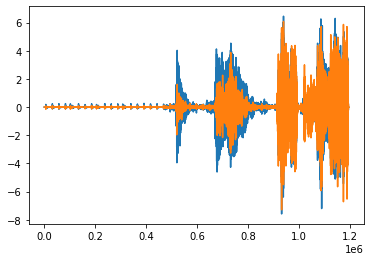

In [387]:
plt.plot(prop1_est_sources[0]*3.16)
plt.plot(prop2_est_sources_6[0])


# plt.plot(prop2_est_sources_5[3])


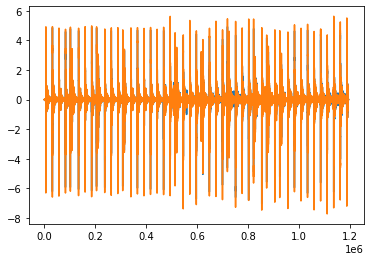

In [390]:
plt.plot(prop1_est_sources[1])
plt.plot(prop2_est_sources_6[1])


# plt.plot(prop2_est_sources_5[3])


In [ ]:
plt.plot(prop2_est_sources_6[3])
plt.plot(prop2_est_sources_5[3])

In [356]:
sdr, sir, sar, perm \
= mir_eval.separation.bss_eval_sources(prop2_sources,prop2_est_sources, compute_permutation=False)

In [357]:
print('sdr:{:.5f},{:.5f},{:.5f},{:.5f}\nsir:{:.5f},{:.5f},{:.5f},{:.5f}\nsar:{:.5f},{:.5f},{:.5f},{:.5f}\n'
      .format(sdr[0],sdr[1],sdr[2],sdr[3], \
              sir[0],sir[1],sir[2],sir[3],\
              sar[0],sar[1],sar[2],sar[3]))

sdr:-0.70474,14.03929,6.49513,1.01176
sir:1.94748,19.73863,13.52654,3.30281
sar:4.84065,15.44715,7.64252,6.55011



In [400]:
sdr, sir, sar, perm \
= mir_eval.separation.bss_eval_sources(prop1_sources+1e-20,prop1_est_sources, compute_permutation=False)

In [401]:
print('sdr:{:.2f},{:.2f},{:.2f},{:.2f}\nsir:{:.2f},{:.2f},{:.2f},{:.2f}\nsar:{:.2f},{:.2f},{:.2f},{:.2f}\n'
      .format(sdr[0],sdr[1],sdr[2],sdr[3], \
              sir[0],sir[1],sir[2],sir[3],\
              sar[0],sar[1],sar[2],sar[3]))

sdr:-3.64,13.99,6.25,-1.35
sir:-2.28,19.83,12.37,0.28
sar:6.37,15.35,7.72,6.57



In [400]:
ratio = np.array([3.162, 1, 1, 3.162])[:, None]
sdr, sir, sar, perm \
= mir_eval.separation.bss_eval_sources(prop1_sources*ratio,prop1_est_sources, compute_permutation=False)

In [401]:
print('sdr:{:.2f},{:.2f},{:.2f},{:.2f}\nsir:{:.2f},{:.2f},{:.2f},{:.2f}\nsar:{:.2f},{:.2f},{:.2f},{:.2f}\n'
      .format(sdr[0],sdr[1],sdr[2],sdr[3], \
              sir[0],sir[1],sir[2],sir[3],\
              sar[0],sar[1],sar[2],sar[3]))

sdr:-3.64,13.99,6.25,-1.35
sir:-2.28,19.83,12.37,0.28
sar:6.37,15.35,7.72,6.57



In [397]:
sdr, sir, sar, perm

(array([11.76089551]), array([inf]), array([11.76089551]), array([0]))

In [403]:
sdr, sir, sar, perm \
= mir_eval.separation.bss_eval_sources(base_sources+1e-20,base_est_sources+1e-20, compute_permutation=False)

In [404]:
print('sdr:{:.2f},{:.2f},{:.2f},{:.2f}\nsir:{:.2f},{:.2f},{:.2f},{:.2f}\nsar:{:.2f},{:.2f},{:.2f},{:.2f}\n'
      .format(sdr[0],sdr[1],sdr[2],sdr[3], \
              sir[0],sir[1],sir[2],sir[3],\
              sar[0],sar[1],sar[2],sar[3]))

sdr:-27.29,8.69,-12.54,5.74
sir:-113.17,-72.59,-94.28,-77.88
sar:-0.00,0.00,-0.00,0.00



In [391]:
sf.write('prop2_0.wav', prop2_est_sources[0]/max(prop2_est_sources[0]), 44100, 'PCM_24')
sf.write('baseline_0.wav', base_est_sources[0]/max(base_est_sources[0]), 44100, 'PCM_24')

In [158]:
r_id = 0
prop2_est_remix_0 = torch.load(prop_path +
                                 '0428_163148_remixture_{}_{}.pth'
                                 .format(track_id, r_id)).cpu().data.numpy()
r_id = 4
prop2_est_remix_4 = torch.load(prop_path +
                                 '0428_163148_remixture_{}_{}.pth'
                                 .format(track_id, r_id)).cpu().data.numpy()